In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nilearn.plotting import plot_design_matrix
import statsmodels.api as sm
import os
import shutil

In [2]:
outdir = '/Users/jeanettemumford/sherlock_home/efficiency/output'


def get_events_eff_data(outdir, task):
    events_all = []
    for i in range(1,6):
        events = pd.read_pickle(f'{outdir}/{task}_events_{i}.pkl') 
        events_all.extend(events)

    output_list = []

    for i in range(1,6):
        output_list.append(pd.read_csv(f'{outdir}/{task}_output_{i}.csv'))
    output_all = pd.concat(output_list, ignore_index=True)
    output_all = output_all.loc[:, ~output_all.columns.str.contains('^Unnamed')]
    ranks = {col: np.argsort(output_all[col].to_numpy()) for col in output_all.columns}
    return events_all, output_all, ranks

In [3]:
def draw_histograms(output, overlap_array, variables, n_rows, n_cols):
    '''
    Plots histogram and location of top model picks
    '''
    line_colors = sns.color_palette("bright", len(overlap_array))
    fig=plt.figure(figsize=(12, 12))
    for i, var_name in enumerate(variables):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.hist(output[var_name], 100, color='lightgray')
        if 'vif' in var_name:
            ax.axvline(x=5, color='black', 
                    linewidth=2)
        for color_ind, index in enumerate(overlap_array):
            ax.axvline(x=output[var_name][index], color=line_colors[color_ind], 
                    linewidth=1, label=index)
        ax.set_title(var_name)
        ax.legend(fontsize=7)
    fig.tight_layout()  
    plt.show()

In [32]:
def save_chosen_events_files(task, output, events, overlap_array):
    root = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc/final_designs'
    outdir = f'{root}/{task}'
    if os.path.exists(outdir):
        shutil.rmtree(outdir)
    os.makedirs(outdir)
    for save_index in overlap_array:
        events[save_index].to_csv(f'{outdir}/{task}_events_{save_index}.csv')
    output_save = output.iloc[overlap_array,:]
    output_save.to_csv(f'{outdir}/{task}_model_assessment_values.csv')

## Flanker and Stroop

In [4]:
events_flanker_stroop, output_flanker_stroop, ranks_flanker_stroop = get_events_eff_data(outdir, 'flanker_stroop')

In [5]:
#check that all simulations ran
print(output_flanker_stroop.shape)

(100000, 15)


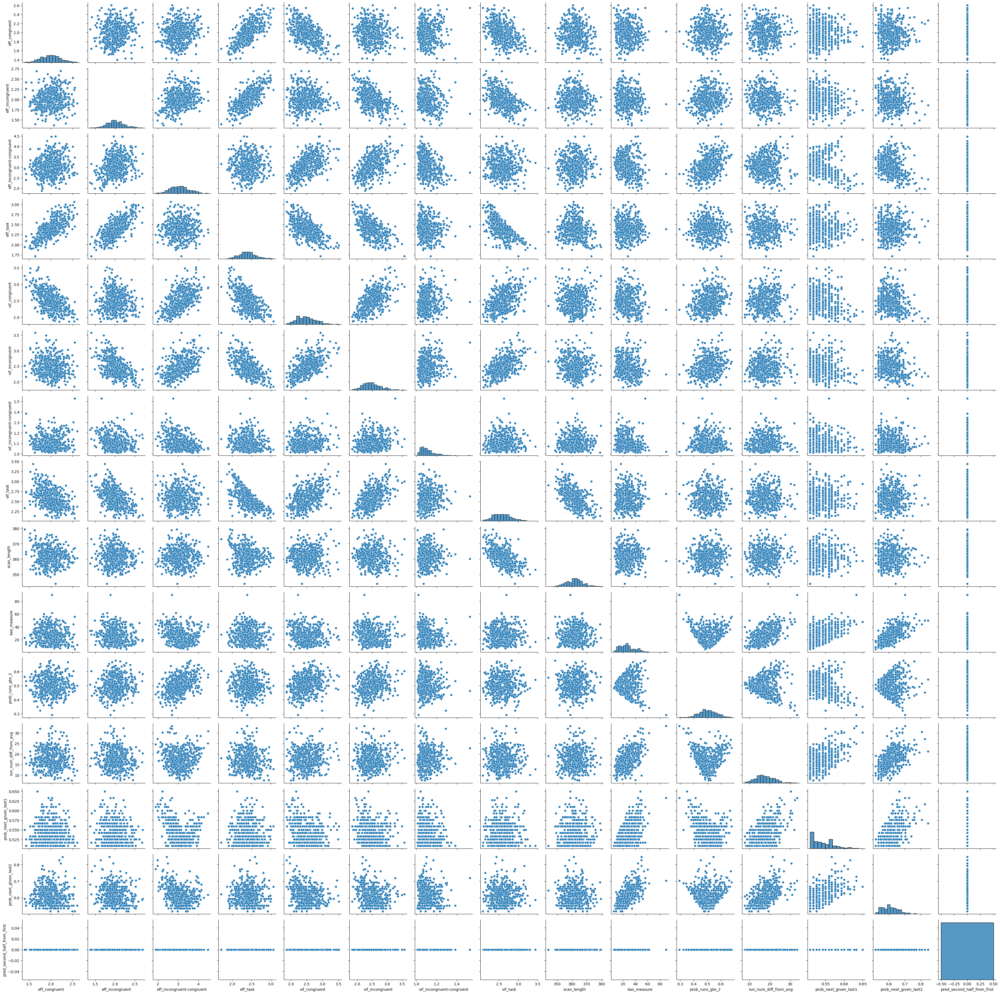

In [6]:
# Check subset of data to see that patterns are reasonable
g = sns.PairGrid(output_flanker_stroop.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

### Notes from the scatterplots
It seems the predict second half from first half code isn't working well.  It will be omitted and the focus will be on all of the other psychological measures.

For the next bit of code, I manually set `top_number` until I got 20 designs for Patrick and his team to choose from.  They will use 10 for Flanker and 10 for Stroop.

In [14]:
# For some measures good = higher and for others, good = lower.  This makes that distinction 
#  so that ranks are treated properly
best_high = [name for name in output_flanker_stroop.columns if 'eff' in name]
best_low = [name for name in output_flanker_stroop.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 35000

overlap_set = set(np.arange(output_flanker_stroop.shape[0]))
for high_label in best_high:
    overlap_set = set.intersection(overlap_set, ranks_flanker_stroop[high_label][-top_number:])
for low_label in best_low:
    overlap_set = set.intersection(overlap_set, ranks_flanker_stroop[low_label][:top_number])
len_overlap_set = len(overlap_set)

print(overlap_set)
overlap_array = np.array(list(overlap_set))
print(len(overlap_array))

{73090, 33411, 49630, 59047, 6312, 329, 24299, 68209, 31794, 15422}
10


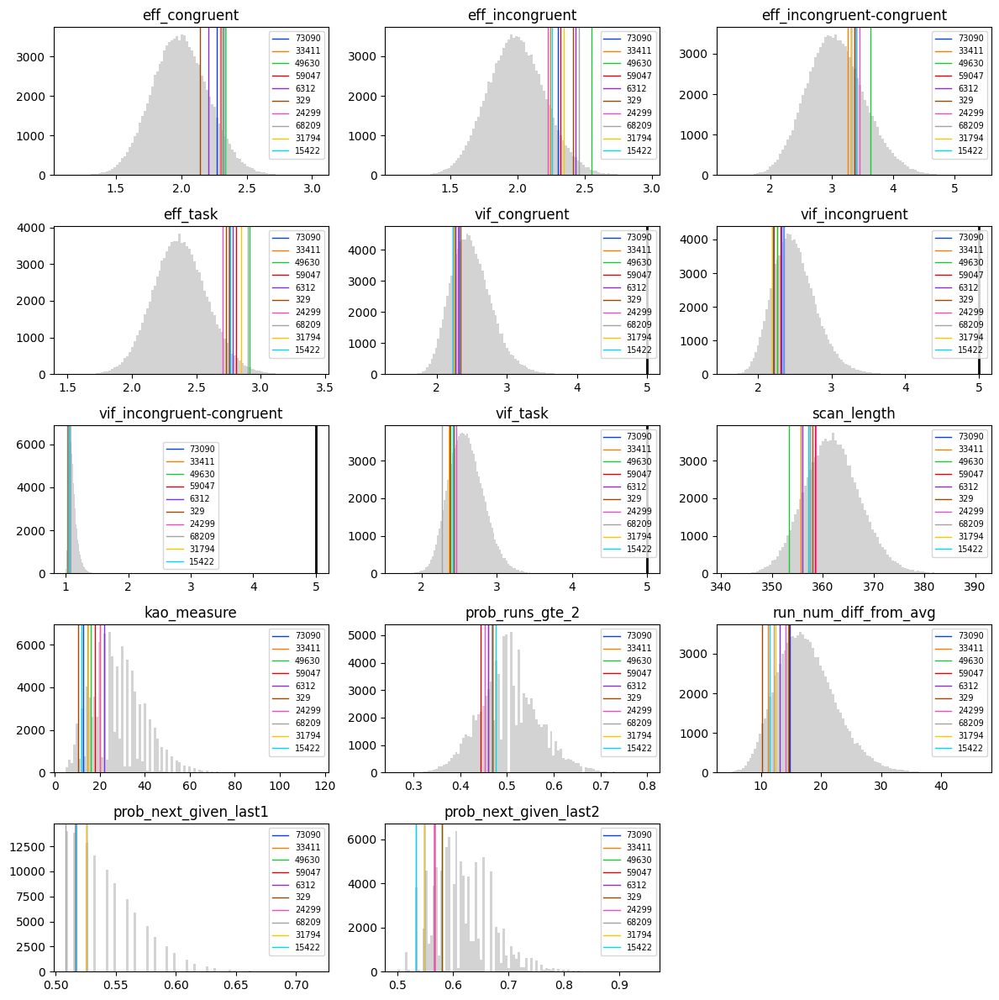

[73090 33411 49630 59047  6312   329 24299 68209 31794 15422]


In [15]:
all_labels = best_high + best_low
draw_histograms(output_flanker_stroop, overlap_array, all_labels, 5, 3)
print(overlap_array)

In [33]:
save_chosen_events_files('flanker_stroop', output_flanker_stroop, events_flanker_stroop, overlap_array)

## GoNoGo

In [35]:
outdir = '/Users/jeanettemumford/sherlock_home/efficiency/output'
events_gng, output_gng, ranks_gng = get_events_eff_data(outdir, 'gng')

In [36]:
print(output_gng.shape)

(100000, 15)


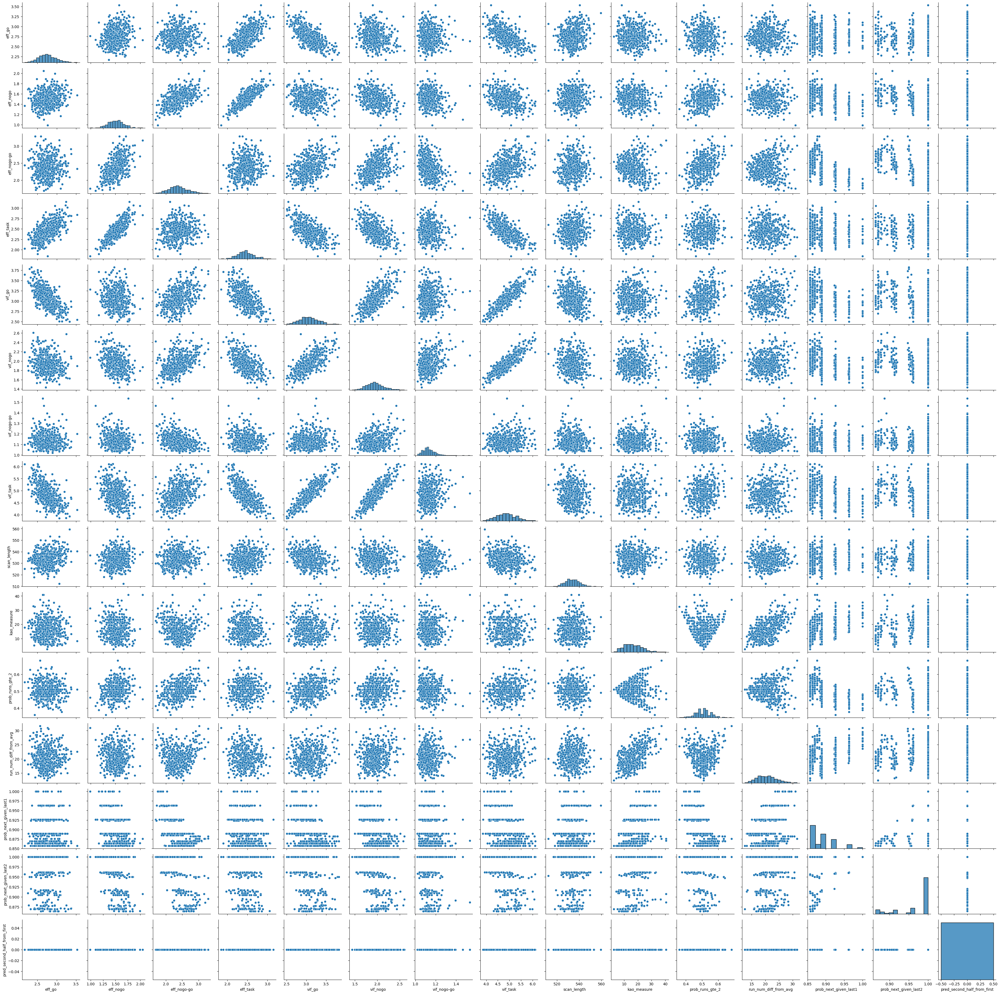

In [37]:
g = sns.PairGrid(output_gng.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [102]:
# Since only 1/7 of the trials are no-go, the prob_runs_gte2, prob_next_given_last1, prob_next_given_last2
# are not useful measures (will always be high), so the focus is on the remaining measures that compare to 
# the expected averages
best_high = [name for name in output_gng.columns if 'eff' in name]
best_low = [name for name in output_gng.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'run_num_diff_from_avg']


top_number = 24000

overlap_set_gng = set(np.arange(output_gng.shape[0]))
for high_label in best_high:
    overlap_set_gng = set.intersection(overlap_set_gng, ranks_gng[high_label][-top_number:])
for low_label in best_low:
    overlap_set_gng = set.intersection(overlap_set_gng, ranks_gng[low_label][:top_number])
len_overlap_set_gng = len(overlap_set_gng)

print(overlap_set_gng)
overlap_array_gng = np.array(list(overlap_set_gng))
print(len(overlap_array_gng))

{88337, 53204, 29911, 58200, 18175}
5


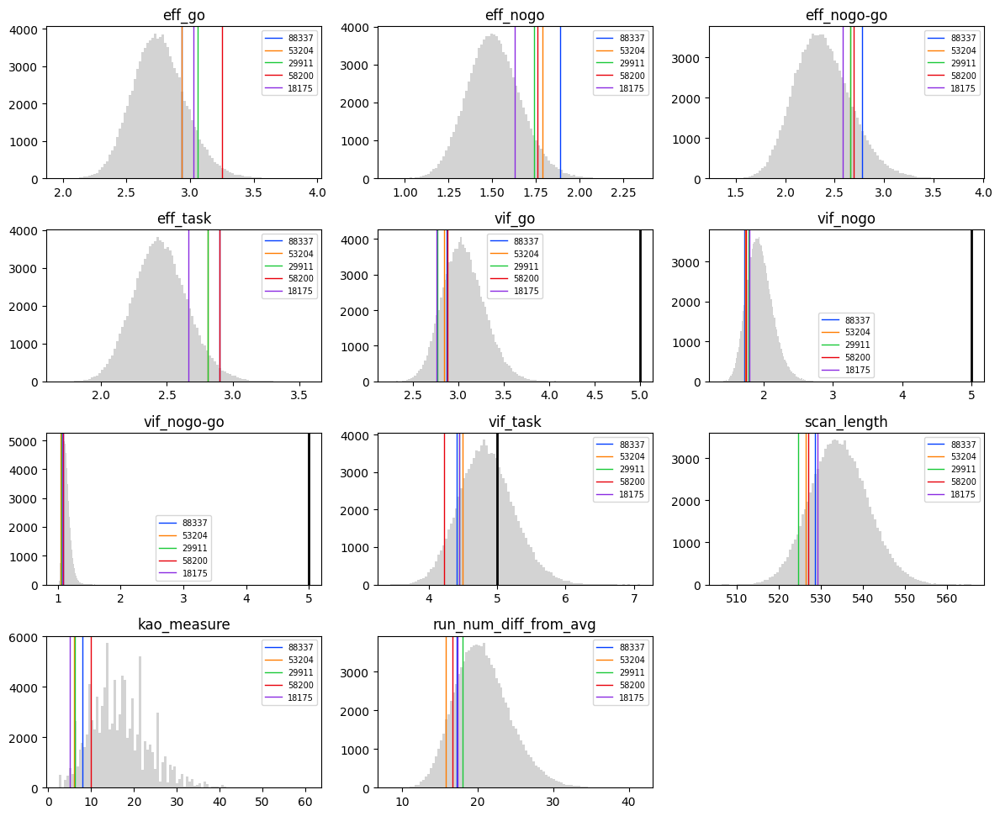

[88337 53204 29911 58200 18175]


In [103]:
all_labels = best_high + best_low
draw_histograms(output_gng, overlap_array_gng, all_labels, 5, 3)
print(overlap_array_gng)




In [104]:

save_chosen_events_files('gng', output_gng, events_gng, overlap_array_gng)

## Stop signal

In [105]:
events_stop_signal, output_stop_signal, ranks_stop_signal = get_events_eff_data(outdir, 'stop_signal')

In [106]:
print(output_stop_signal.shape)

(100000, 15)


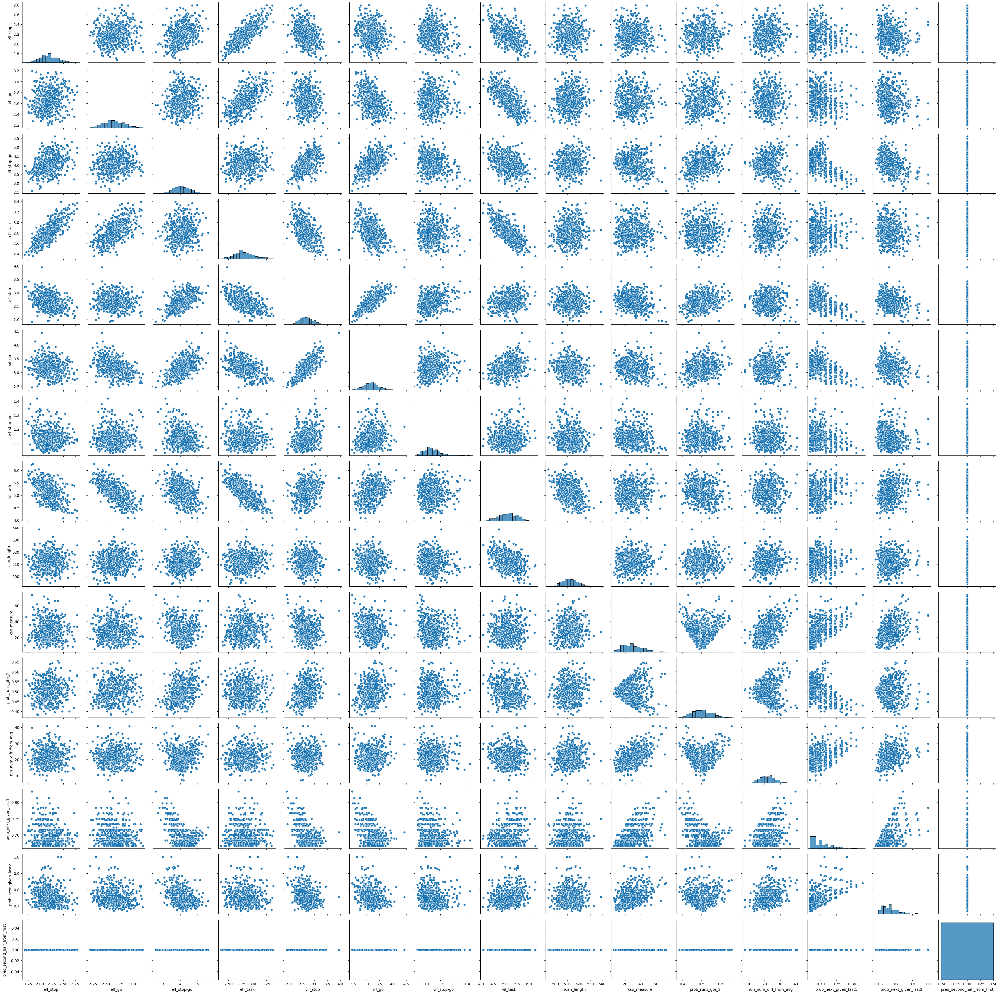

In [107]:
g = sns.PairGrid(output_stop_signal.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [114]:
best_high = [name for name in output_stop_signal.columns if 'eff' in name]
best_low = [name for name in output_stop_signal.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 37000

overlap_set_stop_signal = set(np.arange(output_stop_signal.shape[0]))
for high_label in best_high:
    overlap_set_stop_signal = set.intersection(overlap_set_stop_signal, ranks_stop_signal[high_label][-top_number:])
for low_label in best_low:
    overlap_set_stop_signal = set.intersection(overlap_set_stop_signal, ranks_stop_signal[low_label][:top_number])
len_overlap_set_stop_signal = len(overlap_set_stop_signal)

print(overlap_set_stop_signal)
overlap_array_stop_signal = np.array(list(overlap_set_stop_signal))
print(len(overlap_array_stop_signal))

{92817, 83441, 77044, 41046, 36184}
5


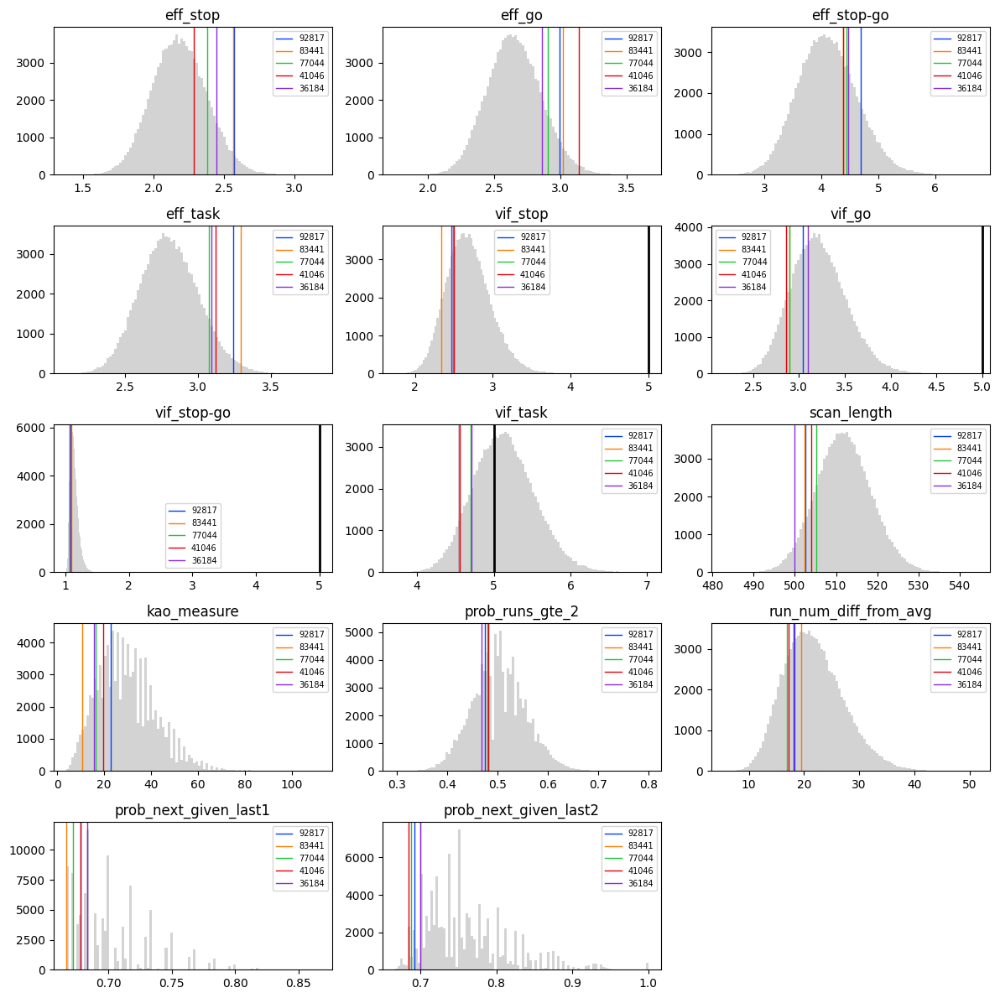

[92817 83441 77044 41046 36184]


In [116]:
all_labels = best_high + best_low
draw_histograms(output_stop_signal, overlap_array_stop_signal, all_labels, 5, 3)
print(overlap_array_stop_signal)

save_chosen_events_files('stop_signal', output_stop_signal, events_stop_signal, overlap_array_stop_signal)

## AX CPT

In [188]:
events_ax_cpt, output_ax_cpt, ranks_ax_cpt = get_events_eff_data(outdir, 'ax_cpt')

In [189]:
print(output_ax_cpt.shape)

(100000, 19)


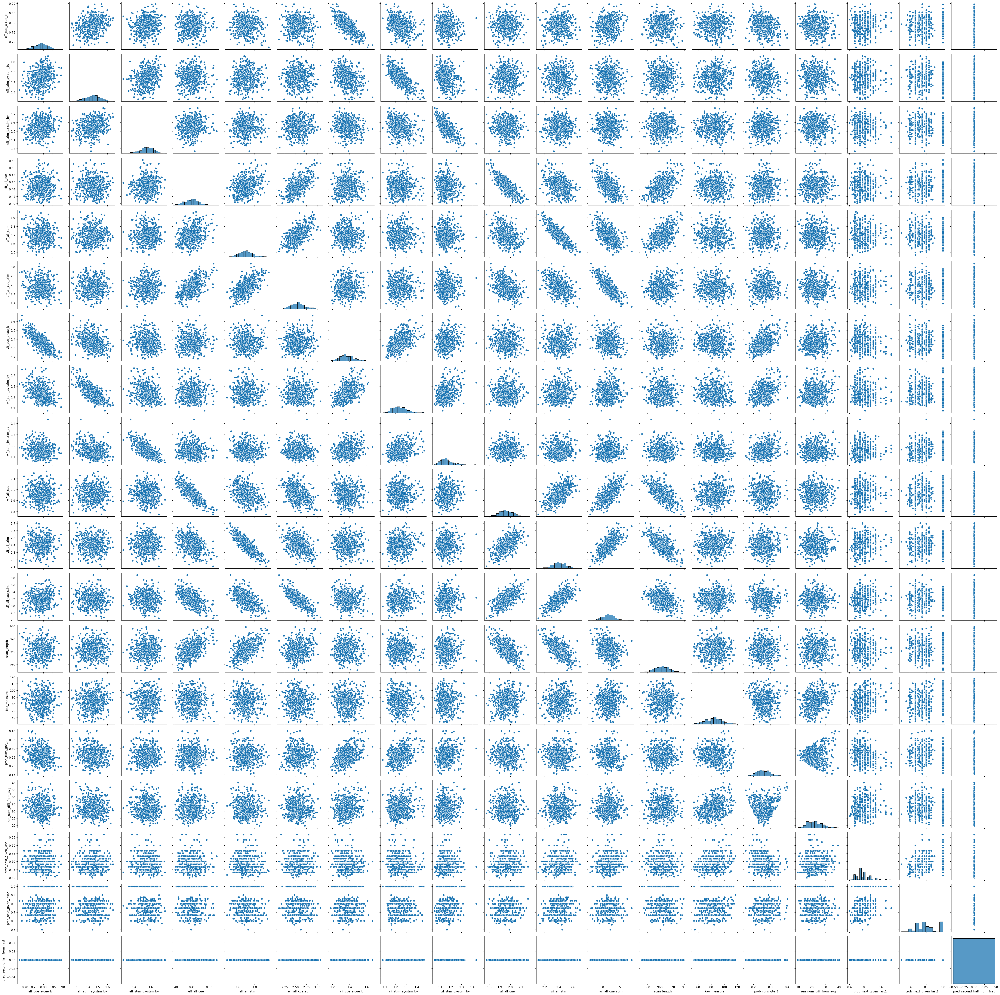

In [190]:
g = sns.PairGrid(output_ax_cpt.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [195]:
best_high = [name for name in output_ax_cpt.columns if 'eff' in name]
best_low = [name for name in output_ax_cpt.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 45500

overlap_set_ax_cpt = set(np.arange(output_ax_cpt.shape[0]))
for high_label in best_high:
    overlap_set_ax_cpt = set.intersection(overlap_set_ax_cpt, ranks_ax_cpt[high_label][-top_number:])
for low_label in best_low:
    overlap_set_ax_cpt = set.intersection(overlap_set_ax_cpt, ranks_ax_cpt[low_label][:top_number])
len_overlap_set_ax_cpt = len(overlap_set_ax_cpt)

print(overlap_set_ax_cpt)
overlap_array_ax_cpt = np.array(list(overlap_set_ax_cpt))
print(len(overlap_array_ax_cpt))

{89765, 6510, 22576, 31828, 80918}
5


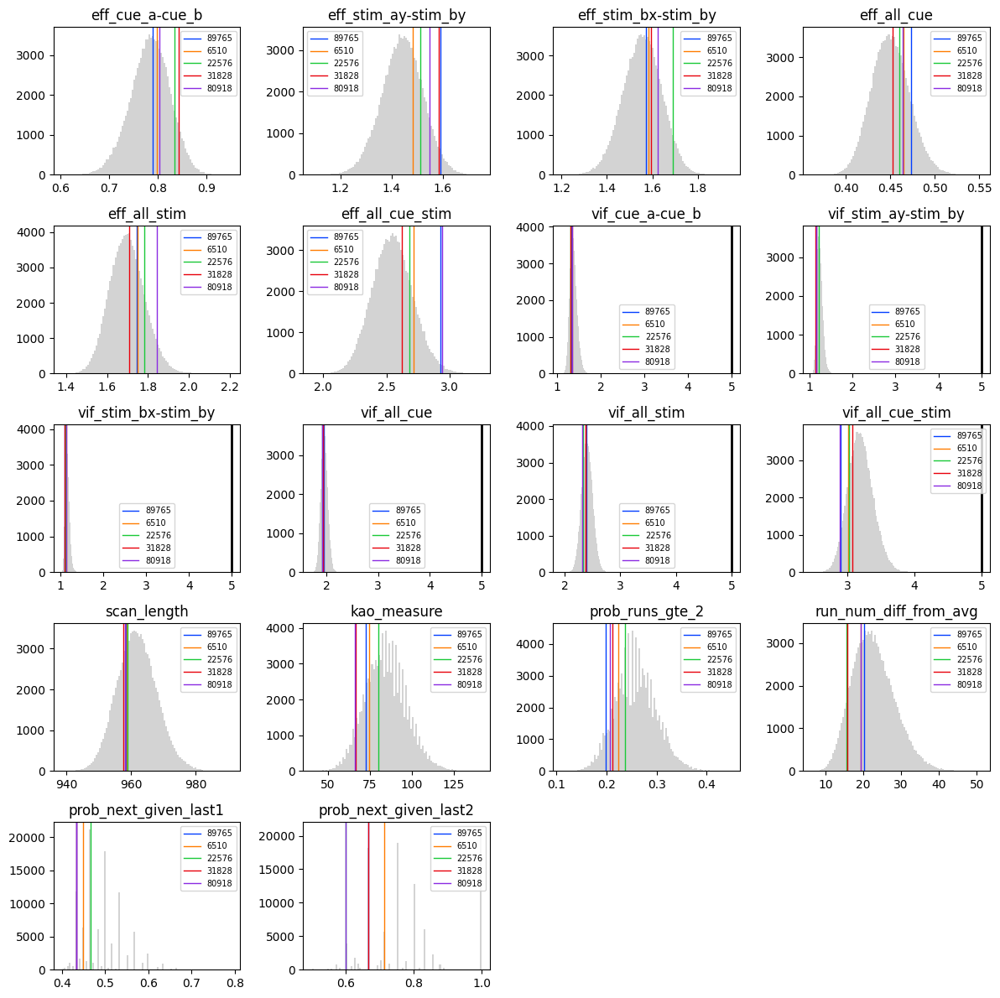

[89765  6510 22576 31828 80918]


In [197]:
all_labels = best_high + best_low
draw_histograms(output_ax_cpt, overlap_array_ax_cpt, all_labels, 5, 4)
print(overlap_array_ax_cpt)

save_chosen_events_files('ax_cpt', output_ax_cpt, events_ax_cpt, overlap_array_ax_cpt)

## Cued TS and Spatial TS

In [137]:
events_cued_ts_spatial_ts, output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts = get_events_eff_data(outdir, 'cued_ts_spatial_ts')

In [221]:
print(output_cued_ts_spatial_ts.shape)

(100000, 13)


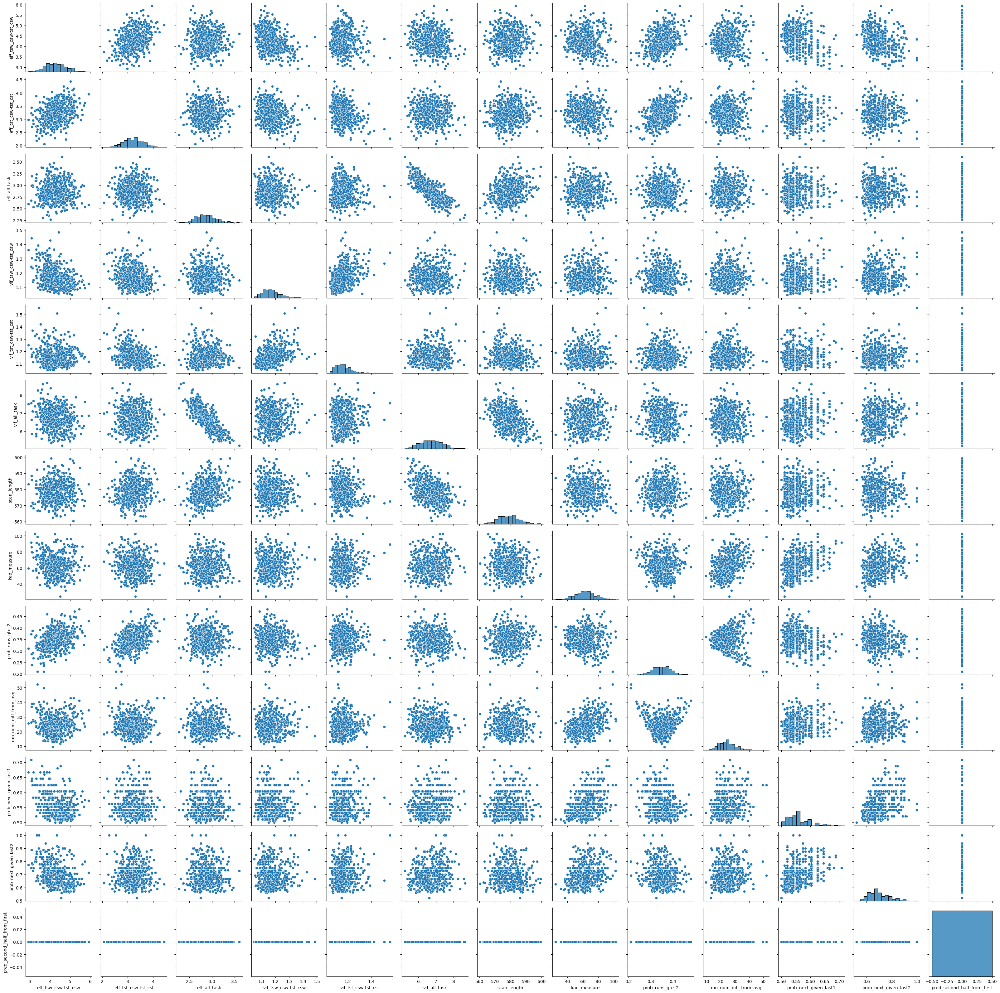

In [139]:
g = sns.PairGrid(output_cued_ts_spatial_ts.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [231]:
best_high = [name for name in output_cued_ts_spatial_ts.columns if 'eff' in name]
best_low = [name for name in output_cued_ts_spatial_ts.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 41000

overlap_set_cued_ts_spatial_ts = set(np.arange(output_cued_ts_spatial_ts.shape[0]))
for high_label in best_high:
    overlap_set_cued_ts_spatial_ts = set.intersection(overlap_set_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts[high_label][-top_number:])
for low_label in best_low:
    overlap_set_cued_ts_spatial_ts = set.intersection(overlap_set_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts[low_label][:top_number])
len_overlap_set_cued_ts_spatial_ts = len(overlap_set_cued_ts_spatial_ts)

print(overlap_set_cued_ts_spatial_ts)
overlap_array_cued_ts_spatial_ts = np.array(list(overlap_set_cued_ts_spatial_ts))
print(len(overlap_array_cued_ts_spatial_ts))

{27397, 91429, 58894, 70319, 97618, 98515, 22780, 87602, 40985, 36764}
10


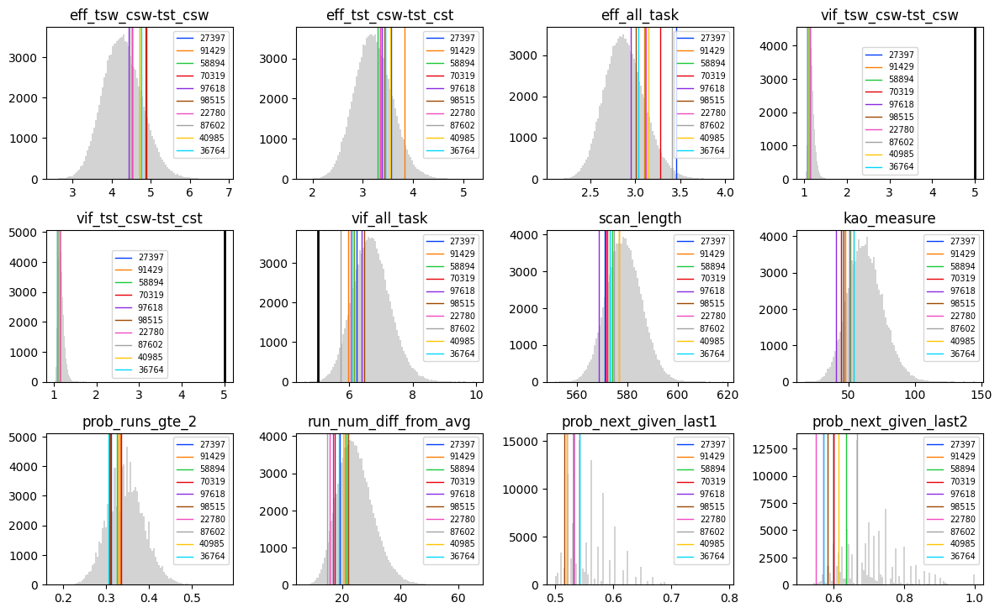

[27397 91429 58894 70319 97618 98515 22780 87602 40985 36764]


In [232]:
all_labels = best_high + best_low
draw_histograms(output_cued_ts_spatial_ts, overlap_array_cued_ts_spatial_ts, all_labels, 5, 4)
print(overlap_array_cued_ts_spatial_ts)

save_chosen_events_files('cued_ts_spatial_ts', output_cued_ts_spatial_ts, events_cued_ts_spatial_ts, overlap_array_cued_ts_spatial_ts)

## Nback

In [146]:
events_nback, output_nback, ranks_nback = get_events_eff_data(outdir, 'nback')
print(output_nback.shape)

(100000, 15)


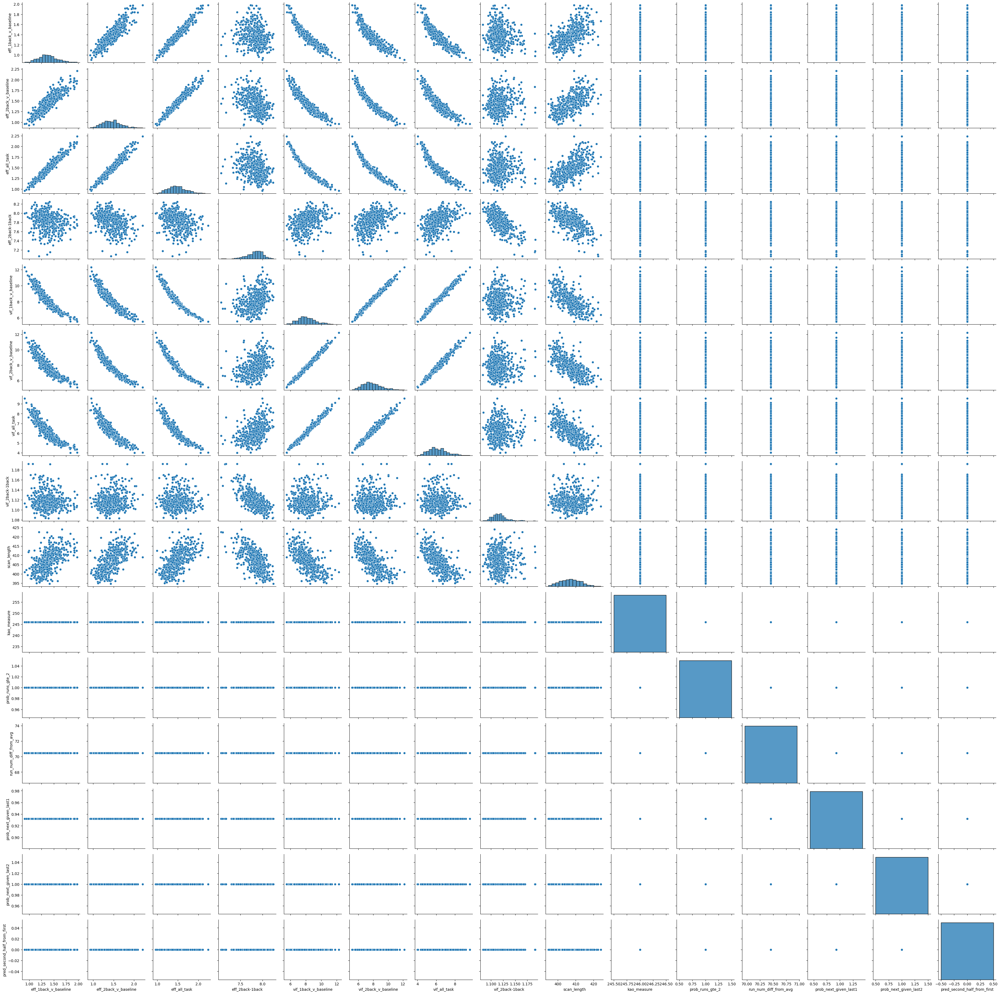

In [147]:
g = sns.PairGrid(output_nback.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [157]:
#none of the psych measures are useful for this task due to the blocks
best_high = [name for name in output_nback.columns if 'eff' in name]
best_low = [name for name in output_nback.columns if 'vif' in name] + \
            ['scan_length']


top_number = 17500

overlap_set_nback = set(np.arange(output_nback.shape[0]))
for high_label in best_high:
    overlap_set_nback = set.intersection(overlap_set_nback, ranks_nback[high_label][-top_number:])
for low_label in best_low:
    overlap_set_nback = set.intersection(overlap_set_nback, ranks_nback[low_label][:top_number])
len_overlap_set_nback = len(overlap_set_nback)

print(overlap_set_nback)
overlap_array_nback = np.array(list(overlap_set_nback))
print(len(overlap_array_nback))

{73056, 31880, 19535, 90897, 88601}
5


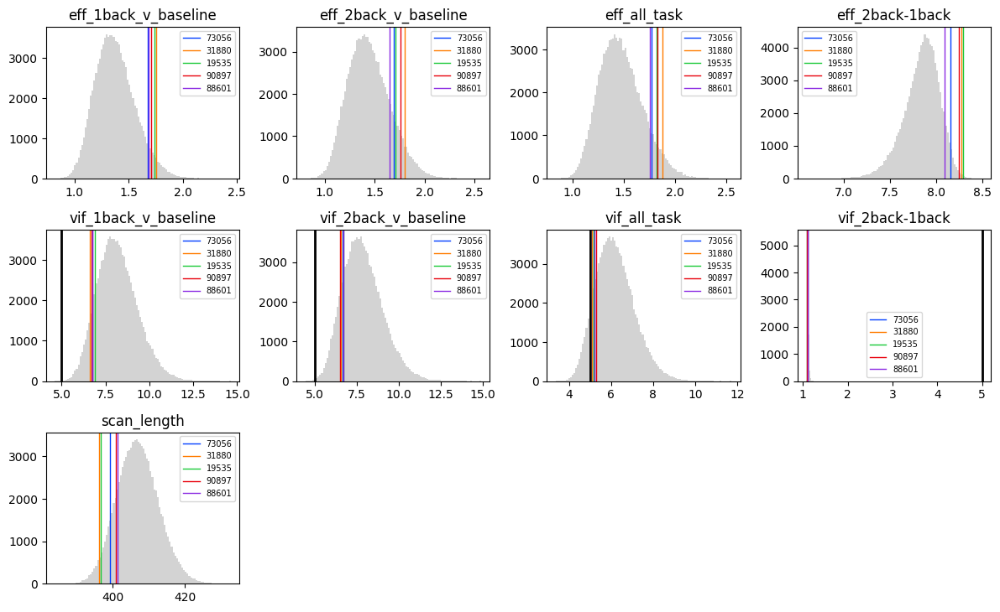

[73056 31880 19535 90897 88601]


In [159]:
all_labels = best_high + best_low
draw_histograms(output_nback, overlap_array_nback, all_labels, 5, 4)
print(overlap_array_nback)

save_chosen_events_files('nback', output_nback, events_nback, overlap_array_nback)

## Span


In [160]:
events_span, output_span, ranks_span = get_events_eff_data(outdir, 'span')

In [161]:
print(output_span.shape)

(100000, 5)


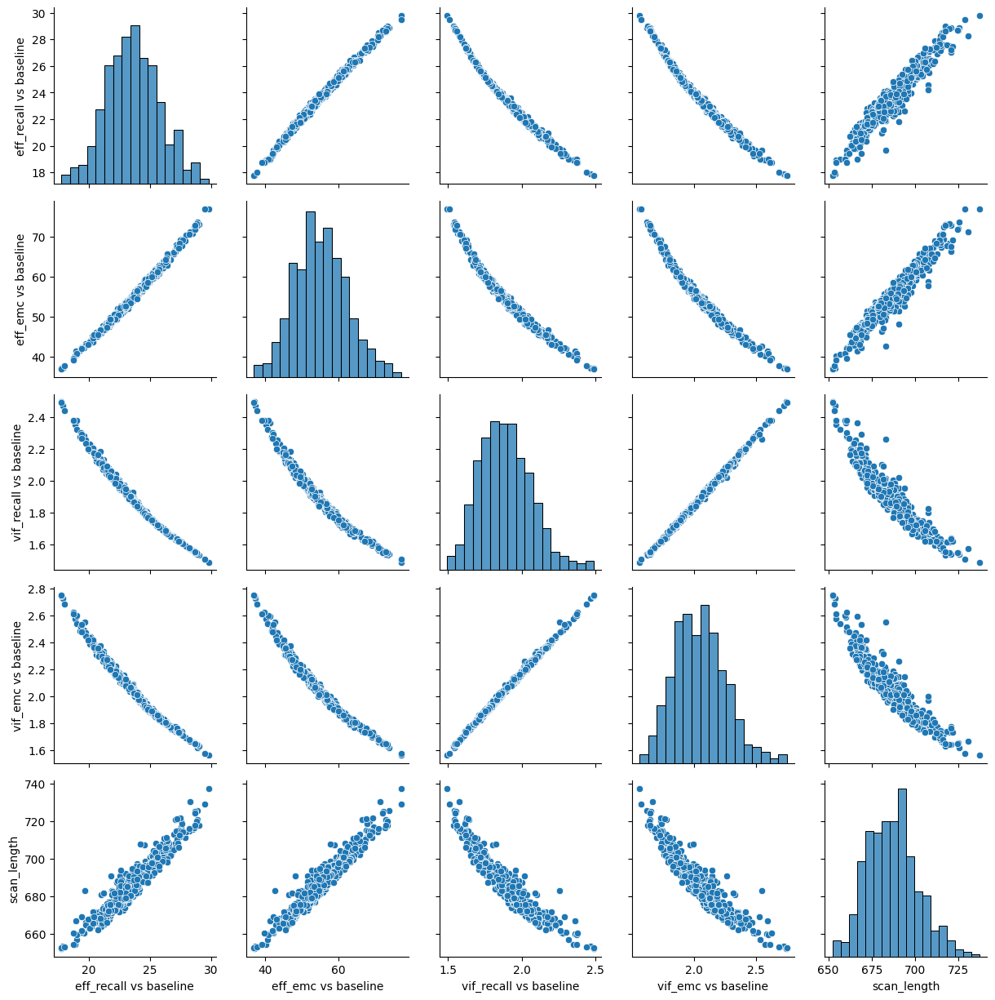

In [162]:
g = sns.PairGrid(output_span.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [186]:
best_high = [name for name in output_span.columns if 'eff' in name]
best_low = [name for name in output_span.columns if 'vif' in name] + \
            ['scan_length']


top_number = 40200

overlap_set_span = set(np.arange(output_span.shape[0]))
for high_label in best_high:
    overlap_set_span = set.intersection(overlap_set_span, ranks_span[high_label][-top_number:])
for low_label in best_low:
    overlap_set_span = set.intersection(overlap_set_span, ranks_span[low_label][:top_number])
len_overlap_set_span = len(overlap_set_span)

print(overlap_set_span)
overlap_array_span = np.array(list(overlap_set_span))
print(len(overlap_array_span))

{16810, 4273, 82236, 7070, 12543}
5


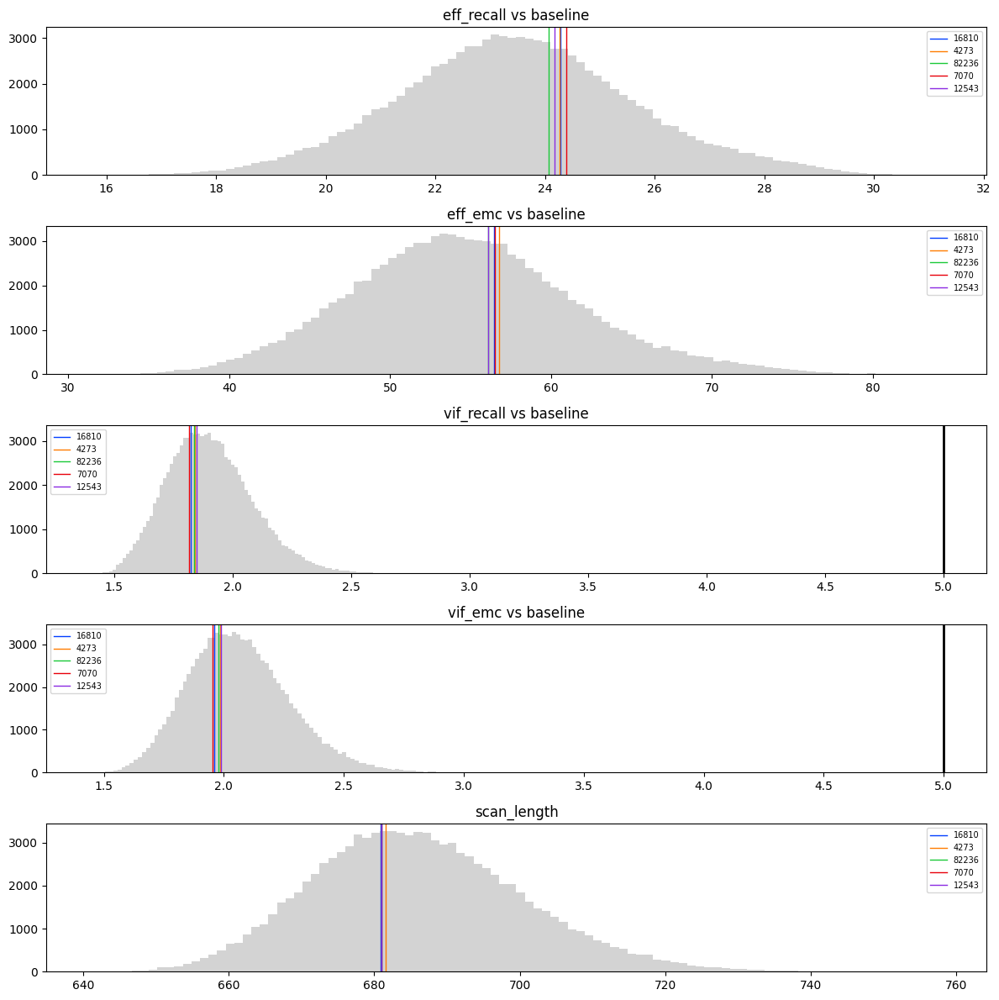

[16810  4273 82236  7070 12543]


In [187]:
all_labels = best_high + best_low 
draw_histograms(output_span, overlap_array_span, all_labels, 5, 1)
print(overlap_array_span)

save_chosen_events_files('span', output_span, events_span, overlap_array_span)

## Spatial Cueing

In [198]:
events_spatial_cueing, output_spatial_cueing, ranks_spatial_cueing = get_events_eff_data(outdir, 'spatial_cueing')
print(output_spatial_cueing.shape)

(100000, 13)


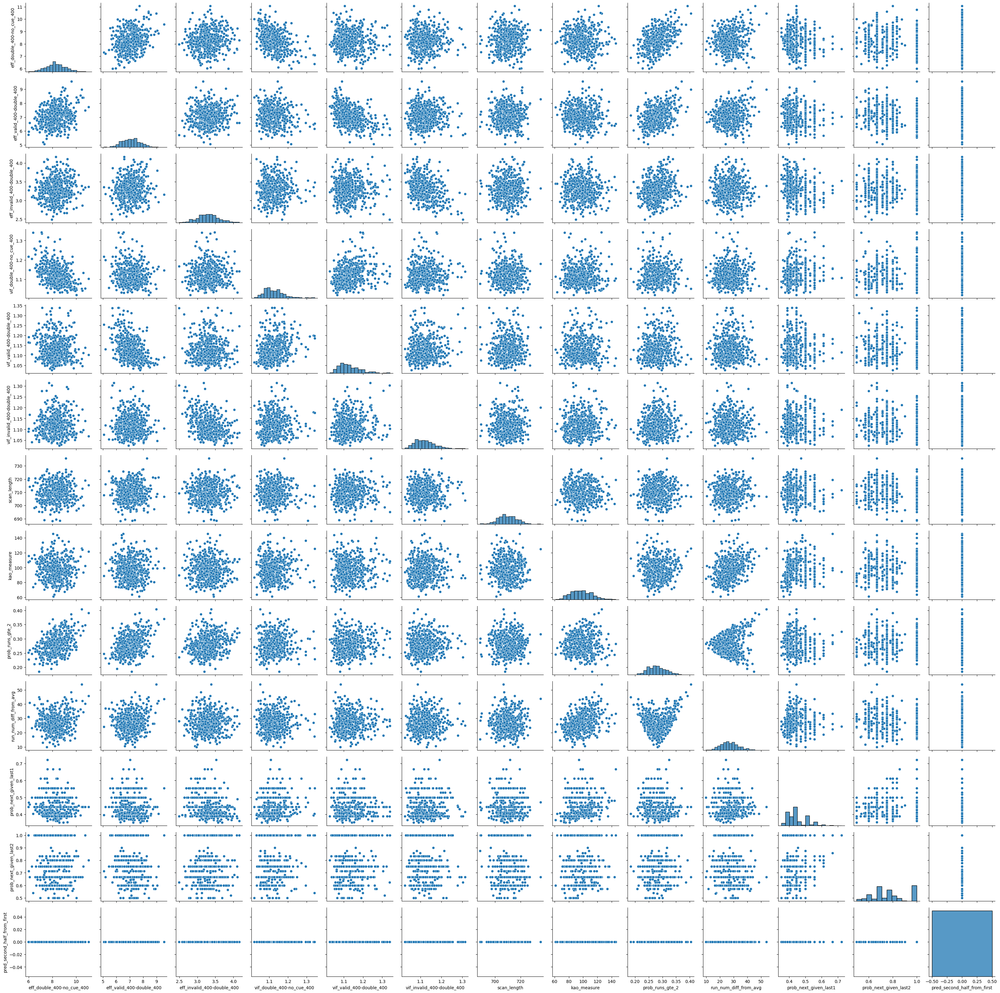

In [199]:
g = sns.PairGrid(output_spatial_cueing.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [207]:
best_high = [name for name in output_spatial_cueing.columns if 'eff' in name]
best_low = [name for name in output_spatial_cueing.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 38300

overlap_set_spatial_cueing = set(np.arange(output_spatial_cueing.shape[0]))
for high_label in best_high:
    overlap_set_spatial_cueing = set.intersection(overlap_set_spatial_cueing, ranks_spatial_cueing[high_label][-top_number:])
for low_label in best_low:
    overlap_set_spatial_cueing = set.intersection(overlap_set_spatial_cueing, ranks_spatial_cueing[low_label][:top_number])
len_overlap_set_spatial_cueing = len(overlap_set_spatial_cueing)

print(overlap_set_spatial_cueing)
overlap_array_spatial_cueing = np.array(list(overlap_set_spatial_cueing))
print(len(overlap_array_spatial_cueing))

{18978, 55948, 47598, 67601, 34930}
5


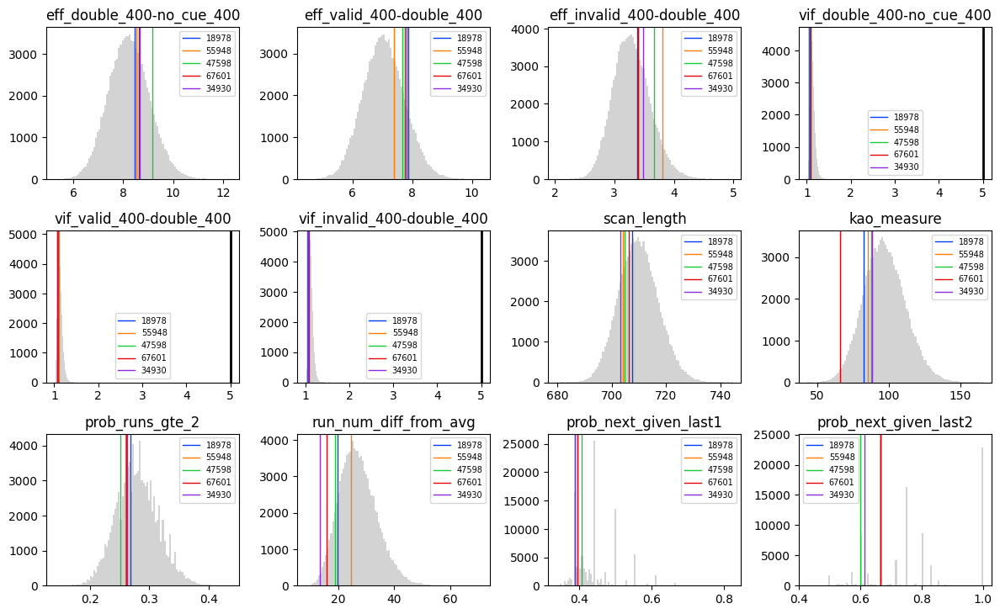

[18978 55948 47598 67601 34930]


In [210]:
all_labels = best_high + best_low 
draw_histograms(output_spatial_cueing, overlap_array_spatial_cueing, all_labels, 5, 4)
print(overlap_array_spatial_cueing)

save_chosen_events_files('spatial_cueing', output_spatial_cueing, events_spatial_cueing, overlap_array_spatial_cueing)

## Visual Search

In [211]:
events_visual_search, output_visual_search, ranks_visual_search = get_events_eff_data(outdir, 'visual_search')
print(output_visual_search.shape)

(100000, 13)


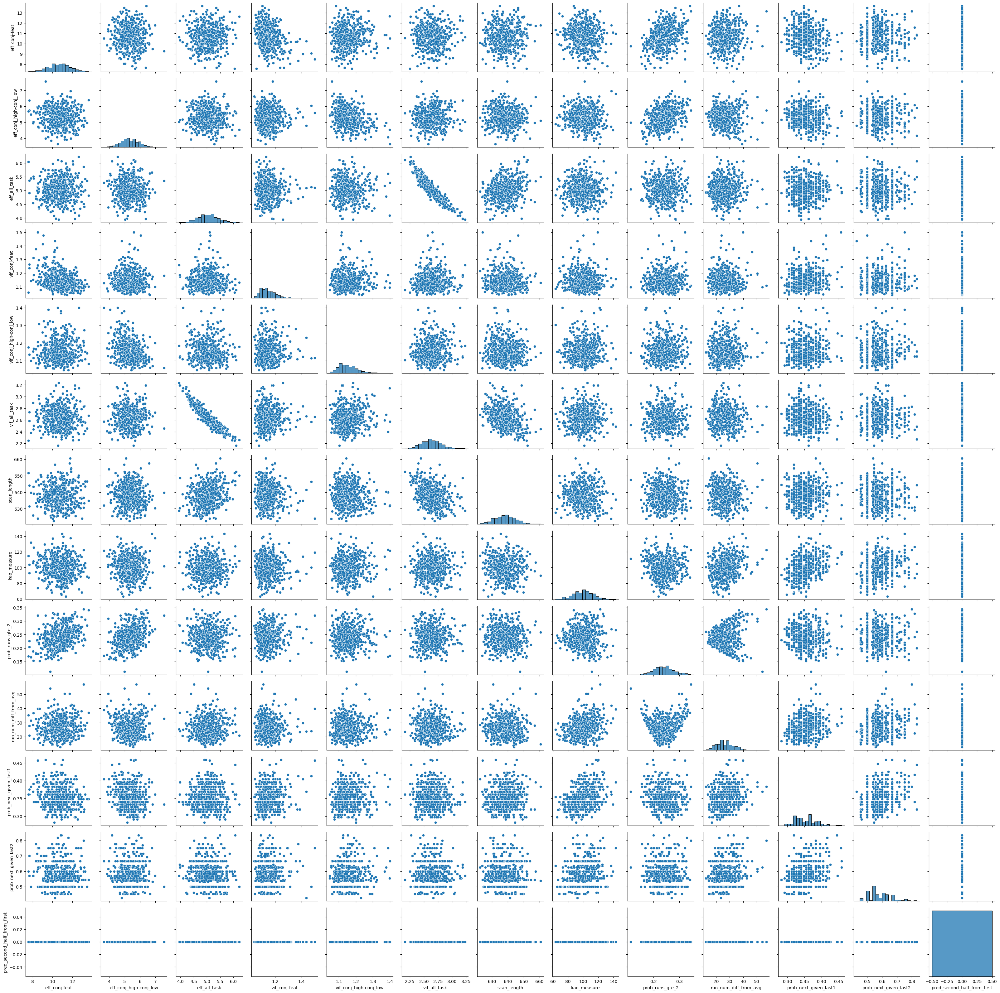

In [212]:
g = sns.PairGrid(output_visual_search.loc[:500,:])
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [217]:
best_high = [name for name in output_visual_search.columns if 'eff' in name]
best_low = [name for name in output_visual_search.columns if 'vif' in name] + \
            ['scan_length', 'kao_measure',
            'prob_runs_gte_2', 'run_num_diff_from_avg',
            'prob_next_given_last1', 'prob_next_given_last2']


top_number = 39000

overlap_set_visual_search = set(np.arange(output_visual_search.shape[0]))
for high_label in best_high:
    overlap_set_visual_search = set.intersection(overlap_set_visual_search, ranks_visual_search[high_label][-top_number:])
for low_label in best_low:
    overlap_set_visual_search = set.intersection(overlap_set_visual_search, ranks_visual_search[low_label][:top_number])
len_overlap_set_visual_search = len(overlap_set_visual_search)

print(overlap_set_visual_search)
overlap_array_visual_search = np.array(list(overlap_set_visual_search))
print(len(overlap_array_visual_search))

{499, 71100, 80989, 92732, 26045}
5


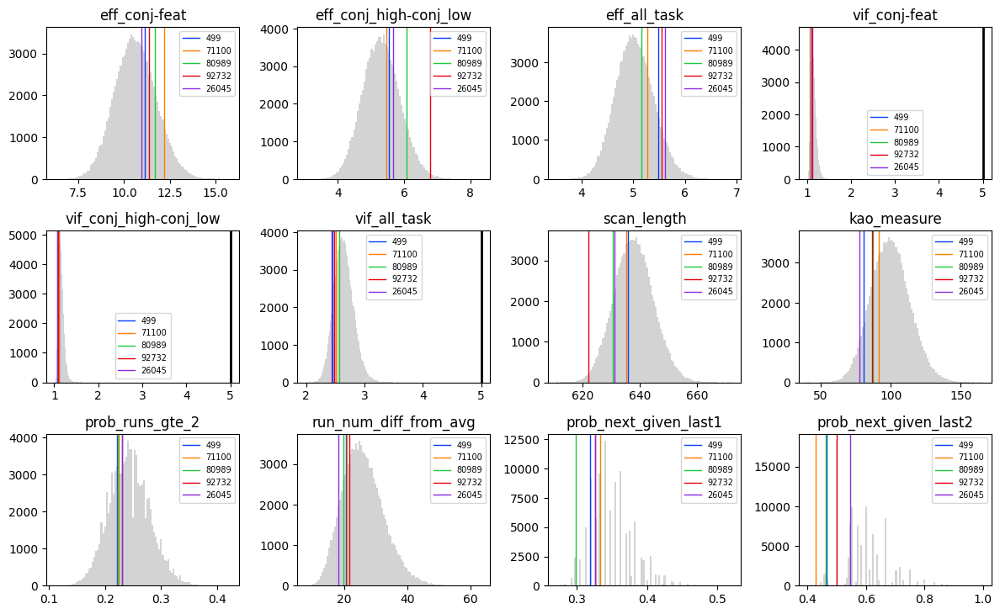

[  499 71100 80989 92732 26045]


In [220]:
all_labels = best_high + best_low 
draw_histograms(output_visual_search, overlap_array_visual_search, all_labels, 5, 4)
print(overlap_array_visual_search)

save_chosen_events_files('visual_search', output_visual_search, events_visual_search, overlap_array_visual_search)